In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
from __future__ import print_function
import argparse
import os

import numpy as np
from keras import backend as K
from keras.callbacks import ModelCheckpoint
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Flatten, Dense, Dropout
from keras.layers import merge
from keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import list_pictures, array_to_img

from image_ext import list_pictures_in_multidir, load_imgs_asarray

import pickle

np.random.seed(2016)

Using TensorFlow backend.


In [2]:
def create_fcn00(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv4)

    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool4)
    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv5)
    pool5 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv5)

    conv6 = Conv2D(1024, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool5)
    conv6 = Conv2D(1024, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv6)

    up7 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv6), conv5])
    conv7 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(up7)
    conv7 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv7)

    up8 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv7), conv4])
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(up8)
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv8)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv8), conv3])
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(up9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv9)

    up10 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv9), conv2])
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(up10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv10)

    up11 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv10), conv1])
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(up11)
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv11)

    conv12 = Conv2D(1, (1, 1), activation='sigmoid', padding='same', data_format='channels_first')(conv11)
    #conv12 = Conv2D(1, 1, 1)(conv11)
    
    fcn = Model(inputs=inputs, outputs=conv12)

    return fcn

In [3]:
def create_fcn01(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv4)

    conv6 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(pool4)
    conv6 = Conv2D(512, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv6)
    
    up8 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv6), conv4])
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(up8)
    conv8 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv8)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv8), conv3])
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(up9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv9)

    up10 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv9), conv2])
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(up10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv10)

    up11 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv10), conv1])
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(up11)
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first')(conv11)

    conv12 = Conv2D(1, (1, 1), activation='sigmoid', padding='same', data_format='channels_first')(conv11)
    #conv12 = Conv2D(1, 1, 1)(conv11)
    
    fcn = Model(inputs=inputs, outputs=conv12)

    return fcn

In [4]:
def create_fcn02(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_1')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_2')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_1')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_2')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_1')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_2')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_1')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_2')(conv4)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv4), conv3])
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv5_1')(up9)
    conv9 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv5_2')(conv9)

    up10 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv9), conv2])
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv6_1')(up10)
    conv10 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv6_2')(conv10)

    up11 = Concatenate(axis=1)([UpSampling2D(size=(2, 2), data_format='channels_first')(conv10), conv1])
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv7_1')(up11)
    conv11 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv7_2')(conv11)

    conv12 = Conv2D(1, (1, 1), activation='sigmoid', padding='same', data_format='channels_first', name='conv8')(conv11)
    #conv12 = Conv2D(1, 1, 1)(conv11)
    
    fcn = Model(inputs=inputs, outputs=conv12)

    return fcn

In [5]:
def create_pupil_net(input_size):
    inputs = Input((3, input_size[1], input_size[0]))

    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_1')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv1_2')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_1')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv2_2')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_1')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv3_2')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format='channels_first')(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_1')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same', data_format='channels_first', name='conv4_2')(conv4)

    full01 = Flatten()(pool1)
    #full01 = Dense(100)(full01)
    full02 = Flatten()(pool2)
    #full02 = Dense(100)(full02)
    full03 = Flatten()(pool3)
    #full03 = Dense(100)(full03)
    full04 = Flatten()(conv4)
    #full04 = Dense(100)(full04)
    
    full = Concatenate()([full01,full02,full03,full04])
    full = Dropout(0.5)(full)
    full = Dense(100)(full)
    #full = Dropout(0.5)(full)
    #full = Dense(50)(full)
    out = Dense(2)(full)
    
    fcn = Model(inputs=inputs, outputs=out)

    return fcn

In [6]:
def load_fnames(paths):
    f = open(paths)
    data1 = f.read()
    f.close()
    lines = data1.split('\n')
    #print(len(lines))
    # 最終行は空行なので消す
    del(lines[len(lines)-1])
    #print(len(lines))
    return lines

In [7]:
def make_fnames(fnames,fpath,fpath_mask,mask_ext):
    fnames_img = [];
    fnames_mask= [];
    
    for i in range(len(fnames)):
        fnames_img.append(fpath + '/' + fnames[i]);
        fnames_mask.append(fpath_mask + '/' + mask_ext + fnames[i]);
        
    return [fnames_img,fnames_mask]

In [22]:
def get_center(im):
    im[im>0] = 1;
    xval = 0
    yval = 0
    npix = 0

    for x in range(0,im.shape[1]):
        xval += (x*sum(im[:,x]))
        npix += sum(im[:,x])
    
    for y in range(0,im.shape[0]):
        yval += (y*sum(im[y,:]))
    
    return [xval/npix,yval/npix]

In [11]:
#
#  MAIN STARTS FROM HERE
#
if __name__ == '__main__':
    
    target_size = (224, 224)
    dpath_this = './'
    dname_checkpoints = 'checkpoints_pupil_net01'
    dname_checkpoints_unet = 'checkpoints01'
    dname_outputs = 'outputs'
    fname_architecture = 'architecture.json'
    fname_weights = "model_weights_{epoch:02d}.h5"
    fname_stats = 'stats01.npz'
    dim_ordering = 'channels_first'
    fname_history = "history.pkl"

    # definision of mode, LEARN or TEST or SHOW_HISTORY
    mode = "LEARN"
    mode = "TEST"

    # モデルを作成
    print('creating model...')
    model = create_fcn02(target_size)
    #model.summary()    
    
    model_pupil_net = create_pupil_net(target_size)
    #model_pupil_net.summary()

creating model...


In [10]:
#
#   LEARNING MODE
#
if mode == "LEARN":
    # Read Learning Data
    fnames = load_fnames('data/list_train_01.txt')
    [fpaths_xs_train,fpaths_ys_train] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_train = load_imgs_asarray(fpaths_xs_train, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_train = load_imgs_asarray(fpaths_ys_train, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering) 

    # Read Validation Data
    fnames = load_fnames('data/list_valid_01.txt')
    [fpaths_xs_valid,fpaths_ys_valid] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_valid = load_imgs_asarray(fpaths_xs_valid, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_valid = load_imgs_asarray(fpaths_ys_valid, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)     

KeyboardInterrupt: 

In [9]:
    # obtain center of pupil
    center_train = []
    center_valid = []
    
    for i in range(Y_train.shape[0]):
        center_train.append(get_center(Y_train[i,0,:,:]))

    for i in range(Y_valid.shape[0]):
        center_valid.append(get_center(Y_valid[i,0,:,:]))
    
    center_train = np.array(center_train)
    center_valid = np.array(center_valid)
    #print(center_train)
    #print(center_valid)

[[110.70689655 120.01149425]
 [114.20848708  98.5904059 ]
 [109.24498886  84.25167038]
 ...
 [109.765625    98.015625  ]
 [106.3265896   94.94508671]
 [110.87634409  96.19892473]]
[[ 94.74580336  91.72182254]
 [110.99551066 113.02693603]
 [100.94652406 119.58823529]
 ...
 [101.08495146  90.49878641]
 [ 96.32061069 113.03816794]
 [123.83091787 101.42995169]]


In [13]:
    print('==> ' + str(len(X_train)) + ' training images loaded')
    print('==> ' + str(len(Y_train)) + ' training masks loaded')
    print('==> ' + str(len(X_valid)) + ' validation images loaded')
    print('==> ' + str(len(Y_valid)) + ' validation masks loaded')

==> 1452 training images loaded
==> 1452 training masks loaded
==> 527 validation images loaded
==> 527 validation masks loaded


In [14]:
    # 前処理
    print('computing mean and standard deviation...')
    mean = np.mean(X_train, axis=(0, 2, 3))
    std = np.std(X_train, axis=(0, 2, 3))
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    print('saving mean and standard deviation to ' + fname_stats + '...')
    stats = {'mean': mean, 'std': std}
    os.mkdir(dname_checkpoints)
    np.savez(dname_checkpoints + '/' + fname_stats, **stats)
    print('==> done')

    print('globally normalizing data...')
    for i in range(3):
        X_train[:, i] = (X_train[:, i] - mean[i]) / std[i]
        X_valid[:, i] = (X_valid[:, i] - mean[i]) / std[i]
    Y_train /= 255
    Y_valid /= 255
    print('==> done')

computing mean and standard deviation...
==> mean: [130.65465  91.2685   76.63643]
==> std : [55.2817   43.990963 43.113483]
saving mean and standard deviation to stats01.npz...


FileExistsError: [Errno 17] File exists: 'checkpoints_pupil_net01'

In [16]:
    # モデルに学習済のU-NET Weightをロードする
    epoch = 300
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    fpath_weights_unet = os.path.join(dname_checkpoints_unet, fname_weights)
    model.load_weights(fpath_weights_unet)
    print('==> done')

==> done


In [17]:
    # load weights from Learned U-NET
    layer_names = ['conv1_1','conv1_2','conv2_1','conv2_2','conv3_1','conv3_2','conv4_1','conv4_2']
    
    print('copying layer weights')
    for name in layer_names:
        print(name)
        model_pupil_net.get_layer(name).set_weights(model.get_layer(name).get_weights())

copying layer weights
conv1_1
conv1_2
conv2_1
conv2_2
conv3_1
conv3_2
conv4_1
conv4_2


In [22]:
    # 損失関数，最適化手法を定義
    adam = Adam(lr=1e-5)
    model_pupil_net.compile(optimizer=adam, loss='mean_squared_error')

    # 構造・重みを保存するディレクトリーの有無を確認
    dpath_checkpoints = os.path.join(dpath_this, dname_checkpoints)
    if not os.path.isdir(dpath_checkpoints):
        os.mkdir(dpath_checkpoints)
    # モデルの構造を保存
    json_string = model.to_json()
    fpath_architecture = os.path.join(dpath_checkpoints, fname_architecture)
    with open(fpath_architecture, "w", encoding="utf8") as f:
        f.write(json_string)
    # 重みを保存するためのオブジェクトを用意
    fname_weights = "model_weights_{epoch:02d}.h5"
    fpath_weights = os.path.join(dpath_checkpoints, fname_weights)
    checkpointer = ModelCheckpoint(filepath=fpath_weights, save_best_only=False)           

./checkpoints_pupil_net01/model_weights_{epoch:02d}.h5


In [25]:
    # トレーニングを開始
    print('start training...')
    history = model_pupil_net.fit(X_train, center_train, batch_size=64, epochs=200, verbose=1,
                  shuffle=True, validation_data=(X_valid, center_valid), callbacks=[checkpointer])

start training...
Train on 1452 samples, validate on 527 samples
Epoch 1/100
1452/1452 [==============================] - 31s 22ms/step - loss: 129.1062 - val_loss: 143.1635
Epoch 2/100
1452/1452 [==============================] - 31s 21ms/step - loss: 108.5962 - val_loss: 126.1123
Epoch 3/100
1452/1452 [==============================] - 31s 21ms/step - loss: 110.8110 - val_loss: 119.1788
Epoch 4/100
1452/1452 [==============================] - 31s 21ms/step - loss: 109.9098 - val_loss: 116.6795
Epoch 5/100
1452/1452 [==============================] - 31s 21ms/step - loss: 125.7857 - val_loss: 127.7885
Epoch 6/100
1452/1452 [==============================] - 31s 21ms/step - loss: 117.4157 - val_loss: 160.1131
Epoch 7/100
1452/1452 [==============================] - 31s 21ms/step - loss: 104.4647 - val_loss: 112.8781
Epoch 8/100
1452/1452 [==============================] - 31s 21ms/step - loss: 95.1211 - val_loss: 126.2834
Epoch 9/100
1452/1452 [==============================] - 31s 21m

In [26]:
    # Save History
    f = open(dname_checkpoints + '/' + fname_history,'wb')
    pickle.dump(history.history,f)
    f.close

<function BufferedWriter.close>

In [19]:
#
#  TEST MODE
#
if mode == "TEST":
    # Prediction (test) mode

    # 学習済みの重みをロード
    epoch = 1
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    fpath_weights = os.path.join(dname_checkpoints, fname_weights)
    model_pupil_net.load_weights(fpath_weights)
    print('==> done')

OSError: Unable to open file (unable to open file: name = 'checkpoints_pupil_net01\model_weights_01.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [23]:
    # Read Test Data
    fnames = load_fnames('data/list_test_01.txt')

    [fpaths_xs_test,fpaths_ys_test] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_test = load_imgs_asarray(fpaths_xs_test, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_test = load_imgs_asarray(fpaths_ys_test, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)

    # Yを初期化
    center_test = []
    for i in range(Y_test.shape[0]):
        center_test.append(get_center(Y_test[i,0,:,:]))
    center_test = np.array(center_test)

    # トレーニング時に計算した平均・標準偏差をロード    
    print('loading mean and standard deviation from ' + fname_stats + '...')
    stats = np.load(dname_checkpoints + '/' + fname_stats)
    mean = stats['mean']
    std = stats['std']
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    for i in range(3):
        X_test[:, i] = (X_test[:, i] - mean[i]) / std[i]
    print('==> done')

loading mean and standard deviation from stats01.npz...
==> mean: [ 130.65464783   91.26850128   76.63642883]
==> std : [ 55.28170013  43.99096298  43.11348343]
==> done


In [24]:
    # テストを開始
    outputs = model_pupil_net.predict(X_test)

In [17]:
    print(outputs)
    print(center_test)

[[ 26.75377655  22.6986618 ]
 [ 36.10738754  27.67496872]
 [ 29.91319466  23.50362206]
 [ 40.53131866  30.30747032]
 [ 31.98296928  28.41407585]
 [ 20.24408722  18.29474831]
 [ 26.12368965  23.68730164]
 [ 30.79161072  26.8730278 ]
 [ 15.22464561  13.37917328]
 [ 14.51484299  12.26875401]
 [ 17.29532433  18.52521324]
 [ 21.66326332  23.43076515]
 [ 24.91503143  19.67230225]
 [ 26.4671154   16.86589813]
 [ 39.07448959  29.85669136]
 [ 22.5451088   19.67061424]
 [ 12.64801502  13.40871716]
 [ 21.77114296  19.66073036]
 [ 14.45086575  16.27384949]
 [ 16.37601852  19.1677227 ]
 [ 18.12724113  21.5411377 ]
 [ 13.70757961  13.84190655]
 [  8.72663307  11.45724869]
 [ 26.5018425   23.15191269]
 [ 17.47489738  21.43598557]
 [ 28.7666111   25.73437881]
 [ 14.93682384  20.15949821]
 [  9.53159618  13.55812263]
 [ 13.25751781  13.67974091]
 [ 15.98325825  15.92742157]
 [ 24.0574894   22.04170036]
 [ 20.05042458  19.16296387]
 [ 24.4754982   22.19386292]
 [ 30.28809547  25.2036972 ]
 [ 25.93781662

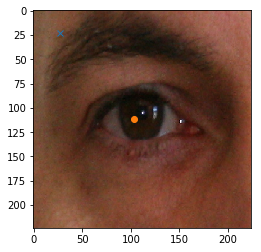

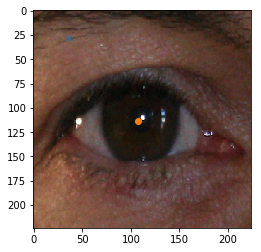

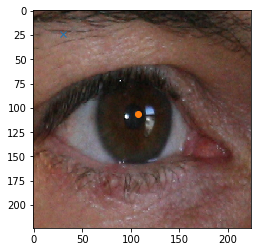

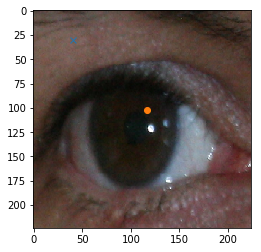

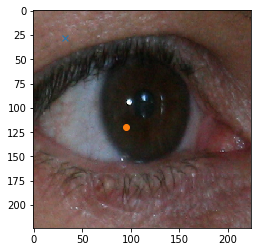

...

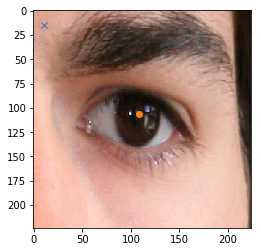

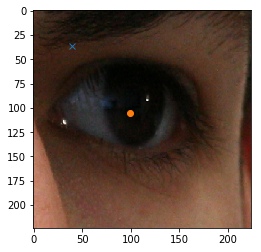

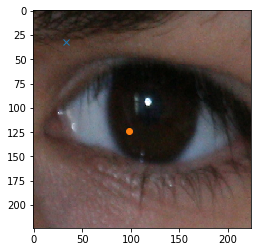

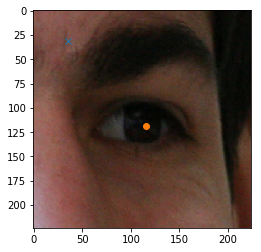

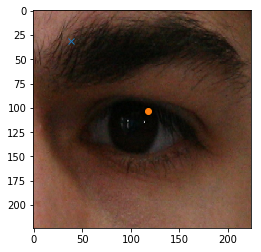

In [21]:
from PIL import Image
import matplotlib.pyplot as plt

n = 0

for i in range(len(fpaths_xs_test)):
    # テスト画像
    im1 = Image.open(fpaths_xs_test[i])
    im1 = im1.resize(target_size) 

    # Show pupil prediction
    plt.imshow(im1)
    plt.plot(outputs[i,0], outputs[i,1],'x')
    plt.plot(center_test[i,0], center_test[i,1], 'o')
    plt.show()

    n = n + 1

In [10]:
#
#   Show History
#
mode = "SHOW_HISTORY"
if mode == "SHOW_HISTORY":
    # load pickle
    print(dname_checkpoints + '/' + fname_history)
    history = pickle.load(open(dname_checkpoints + '/' + fname_history, 'rb'))
    
    for k in history.keys():
        plt.plot(history[k])
        plt.title(k)
        plt.show()


checkpoints01/history.pkl


EOFError: Ran out of input

dict_keys(['val_loss', 'val_dice_coef', 'loss', 'dice_coef'])
